In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)


In [2]:
df=pd.read_excel(r'C:\Users\Siddhant\Desktop\restaurant_train.xlsx')
df.head()

,TITLE,RESTAURANT_ID,CUISINES,TIME,CITY,LOCALITY,RATING,VOTES,COST
0,CASUAL DINING,9438,"Malwani, Goan, North Indian","11am – 4pm, 7:30pm – 11:30pm (Mon-Sun)",Thane,Dombivali East,3.6,49 votes,1200
1,"CASUAL DINING,BAR",13198,"Asian, Modern Indian, Japanese",6pm – 11pm (Mon-Sun),Chennai,Ramapuram,4.2,30 votes,1500
2,CASUAL DINING,10915,"North Indian, Chinese, Biryani, Hyderabadi","11am – 3:30pm, 7pm – 11pm (Mon-Sun)",Chennai,Saligramam,3.8,221 votes,800
3,QUICK BITES,6346,"Tibetan, Chinese",11:30am – 1am (Mon-Sun),Mumbai,Bandra West,4.1,24 votes,800
4,DESSERT PARLOR,15387,Desserts,11am – 1am (Mon-Sun),Mumbai,Lower Parel,3.8,165 votes,300


In [3]:
dfn=pd.read_excel(r'C:\Users\Siddhant\Desktop\restaurant_test.xlsx')
dfn.head()

,TITLE,RESTAURANT_ID,CUISINES,TIME,CITY,LOCALITY,RATING,VOTES
0,CASUAL DINING,4085,"North Indian, Chinese, Mughlai, Kebab",12noon – 12midnight (Mon-Sun),Noida,Sector 18,4.3,564 votes
1,QUICK BITES,12680,"South Indian, Fast Food, Pizza, North Indian",7am – 12:30AM (Mon-Sun),Mumbai,Grant Road,4.2,61 votes
2,CASUAL DINING,1411,"North Indian, Seafood, Biryani, Chinese",11am – 11:30pm (Mon-Sun),Mumbai,Marine Lines,3.8,350 votes
3,None,204,Biryani,"9am – 10pm (Mon, Wed, Thu, Fri, Sat, Sun), 10:...",Faridabad,NIT,3.8,1445 votes
4,QUICK BITES,13453,"South Indian, Kerala",11am – 10pm (Mon-Sun),Kochi,Kaloor,3.6,23 votes


# Basics of the dataset

In [4]:
df.shape

(12690, 9)

In [5]:
dfn.shape

(4231, 8)

In [6]:
df.dtypes

TITLE            object
RESTAURANT_ID     int64
CUISINES         object
TIME             object
CITY             object
LOCALITY         object
RATING           object
VOTES            object
COST              int64
dtype: object

In [7]:
dfn.dtypes

TITLE            object
RESTAURANT_ID     int64
CUISINES         object
TIME             object
CITY             object
LOCALITY         object
RATING           object
VOTES            object
dtype: object

In [8]:
df.columns

Index(['TITLE', 'RESTAURANT_ID', 'CUISINES', 'TIME', 'CITY', 'LOCALITY',
       'RATING', 'VOTES', 'COST'],
      dtype='object')

In [9]:
df.nunique()

TITLE              113
RESTAURANT_ID    11892
CUISINES          4155
TIME              2689
CITY               359
LOCALITY          1416
RATING              32
VOTES             1847
COST                86
dtype: int64

In [10]:
dfn.nunique()

TITLE              86
RESTAURANT_ID    4127
CUISINES         1727
TIME             1183
CITY              151
LOCALITY          834
RATING             31
VOTES            1136
dtype: int64

# -->Finding the missing values

In [11]:
count=df.isnull().sum()
count

TITLE               0
RESTAURANT_ID       0
CUISINES            0
TIME                0
CITY              112
LOCALITY           98
RATING              2
VOTES            1204
COST                0
dtype: int64

In [12]:
count=dfn.isnull().sum()
count

TITLE              0
RESTAURANT_ID      0
CUISINES           0
TIME               0
CITY              35
LOCALITY          30
RATING             2
VOTES            402
dtype: int64

In [13]:
df = df[df.VOTES.notnull()]

In [14]:
dfn = dfn[dfn.VOTES.notnull()]    

In [15]:
count=df.isnull().sum()
count

TITLE             0
RESTAURANT_ID     0
CUISINES          0
TIME              0
CITY             93
LOCALITY         78
RATING            0
VOTES             0
COST              0
dtype: int64

In [16]:
df = df[df.LOCALITY.notnull()]

In [17]:
count=df.isnull().sum()
count

TITLE             0
RESTAURANT_ID     0
CUISINES          0
TIME              0
CITY             15
LOCALITY          0
RATING            0
VOTES             0
COST              0
dtype: int64

In [18]:
df = df[df.CITY.notnull()]

In [19]:
count=df.isnull().sum()
count

TITLE            0
RESTAURANT_ID    0
CUISINES         0
TIME             0
CITY             0
LOCALITY         0
RATING           0
VOTES            0
COST             0
dtype: int64

In [20]:
count=dfn.isnull().sum()
count

TITLE             0
RESTAURANT_ID     0
CUISINES          0
TIME              0
CITY             32
LOCALITY         27
RATING            0
VOTES             0
dtype: int64

In [21]:
dfn = dfn[dfn.LOCALITY.notnull()]  

In [22]:
count=dfn.isnull().sum()
count

TITLE            0
RESTAURANT_ID    0
CUISINES         0
TIME             0
CITY             5
LOCALITY         0
RATING           0
VOTES            0
dtype: int64

In [23]:
dfn = dfn[dfn.CITY.notnull()]  

In [24]:
count=dfn.isnull().sum()
count

TITLE            0
RESTAURANT_ID    0
CUISINES         0
TIME             0
CITY             0
LOCALITY         0
RATING           0
VOTES            0
dtype: int64

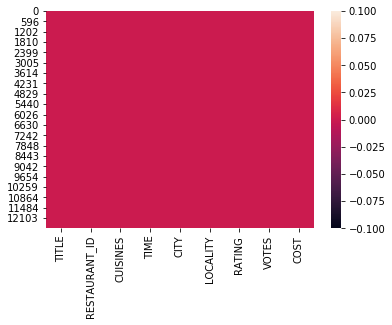

In [25]:
sns.heatmap(df.isnull())

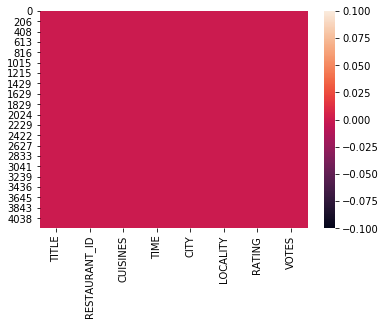

In [26]:
sns.heatmap(dfn.isnull())

# Cleaning of data

In [27]:
df.head()

,TITLE,RESTAURANT_ID,CUISINES,TIME,CITY,LOCALITY,RATING,VOTES,COST
0,CASUAL DINING,9438,"Malwani, Goan, North Indian","11am – 4pm, 7:30pm – 11:30pm (Mon-Sun)",Thane,Dombivali East,3.6,49 votes,1200
1,"CASUAL DINING,BAR",13198,"Asian, Modern Indian, Japanese",6pm – 11pm (Mon-Sun),Chennai,Ramapuram,4.2,30 votes,1500
2,CASUAL DINING,10915,"North Indian, Chinese, Biryani, Hyderabadi","11am – 3:30pm, 7pm – 11pm (Mon-Sun)",Chennai,Saligramam,3.8,221 votes,800
3,QUICK BITES,6346,"Tibetan, Chinese",11:30am – 1am (Mon-Sun),Mumbai,Bandra West,4.1,24 votes,800
4,DESSERT PARLOR,15387,Desserts,11am – 1am (Mon-Sun),Mumbai,Lower Parel,3.8,165 votes,300


In [28]:
dfn.head()

,TITLE,RESTAURANT_ID,CUISINES,TIME,CITY,LOCALITY,RATING,VOTES
0,CASUAL DINING,4085,"North Indian, Chinese, Mughlai, Kebab",12noon – 12midnight (Mon-Sun),Noida,Sector 18,4.3,564 votes
1,QUICK BITES,12680,"South Indian, Fast Food, Pizza, North Indian",7am – 12:30AM (Mon-Sun),Mumbai,Grant Road,4.2,61 votes
2,CASUAL DINING,1411,"North Indian, Seafood, Biryani, Chinese",11am – 11:30pm (Mon-Sun),Mumbai,Marine Lines,3.8,350 votes
3,None,204,Biryani,"9am – 10pm (Mon, Wed, Thu, Fri, Sat, Sun), 10:...",Faridabad,NIT,3.8,1445 votes
4,QUICK BITES,13453,"South Indian, Kerala",11am – 10pm (Mon-Sun),Kochi,Kaloor,3.6,23 votes


In [29]:
new=df['VOTES'].str.split(' ',n=1,expand=True)

In [30]:
df['votes']=new[0]

In [31]:
df.head()

,TITLE,RESTAURANT_ID,CUISINES,TIME,CITY,LOCALITY,RATING,VOTES,COST,votes
0,CASUAL DINING,9438,"Malwani, Goan, North Indian","11am – 4pm, 7:30pm – 11:30pm (Mon-Sun)",Thane,Dombivali East,3.6,49 votes,1200,49
1,"CASUAL DINING,BAR",13198,"Asian, Modern Indian, Japanese",6pm – 11pm (Mon-Sun),Chennai,Ramapuram,4.2,30 votes,1500,30
2,CASUAL DINING,10915,"North Indian, Chinese, Biryani, Hyderabadi","11am – 3:30pm, 7pm – 11pm (Mon-Sun)",Chennai,Saligramam,3.8,221 votes,800,221
3,QUICK BITES,6346,"Tibetan, Chinese",11:30am – 1am (Mon-Sun),Mumbai,Bandra West,4.1,24 votes,800,24
4,DESSERT PARLOR,15387,Desserts,11am – 1am (Mon-Sun),Mumbai,Lower Parel,3.8,165 votes,300,165


In [32]:
new_cuisine = df["CUISINES"].str.split(',',expand=True)

In [33]:
new_cuisine.head()

,0,1,2,3,4,5,6,7
0,Malwani,Goan,North Indian,None,None,None,None,None
1,Asian,Modern Indian,Japanese,None,None,None,None,None
2,North Indian,Chinese,Biryani,Hyderabadi,None,None,None,None
3,Tibetan,Chinese,None,None,None,None,None,None
4,Desserts,None,None,None,None,None,None,None


In [34]:
new_cuisine.rename(columns={0: 'c1',1:'c2',2:'c3',3:'c4',4:'c5',5:'c6',6:'c7',7:'c8'},inplace=True)

In [35]:
new_cuisine.head()

,c1,c2,c3,c4,c5,c6,c7,c8
0,Malwani,Goan,North Indian,None,None,None,None,None
1,Asian,Modern Indian,Japanese,None,None,None,None,None
2,North Indian,Chinese,Biryani,Hyderabadi,None,None,None,None
3,Tibetan,Chinese,None,None,None,None,None,None
4,Desserts,None,None,None,None,None,None,None


In [36]:
new_time = df["TIME"].str.split(')',n=1,expand=True)

In [37]:
new_time

,0,1
0,"11am – 4pm, 7:30pm – 11:30pm (Mon-Sun",
1,6pm – 11pm (Mon-Sun,
2,"11am – 3:30pm, 7pm – 11pm (Mon-Sun",
3,11:30am – 1am (Mon-Sun,
4,11am – 1am (Mon-Sun,
5,12noon – 12:30AM (Mon-Sun,
6,"12noon – 11:30pm (Mon, Tue, Thu, Fri, Sat, Sun",...
7,1pm – 1am (Mon-Sun,
8,7am – 10:30pm (Mon-Sun,
9,"11am – 2pm, 4pm – 10:30pm (Mon-Sun",


In [38]:
df['time']=new_time[0]

In [39]:
df['time']

0                    11am – 4pm, 7:30pm – 11:30pm (Mon-Sun
1                                      6pm – 11pm (Mon-Sun
2                       11am – 3:30pm, 7pm – 11pm (Mon-Sun
3                                   11:30am – 1am (Mon-Sun
4                                      11am – 1am (Mon-Sun
5                                12noon – 12:30AM (Mon-Sun
6           12noon – 11:30pm (Mon, Tue, Thu, Fri, Sat, Sun
7                                       1pm – 1am (Mon-Sun
8                                   7am – 10:30pm (Mon-Sun
9                       11am – 2pm, 4pm – 10:30pm (Mon-Sun
10                              12:30pm – 12:30AM (Mon-Sun
11            11am – 12:15AM (Mon, Tue, Wed, Thu, Fri, Sun
12                                    11am – 11pm (Mon-Sun
14                                             Closed (Mon
15              11:30am – 11:30pm (Mon, Tue, Wed, Thu, Sun
16                            7:30am – 12midnight (Mon-Sun
17                              11am – 12midnight (Mon-S

In [40]:
new_time2 = df["time"].str.split('(',n=1,expand=True)

In [41]:
new_time2 

,0,1
0,"11am – 4pm, 7:30pm – 11:30pm",Mon-Sun
1,6pm – 11pm,Mon-Sun
2,"11am – 3:30pm, 7pm – 11pm",Mon-Sun
3,11:30am – 1am,Mon-Sun
4,11am – 1am,Mon-Sun
5,12noon – 12:30AM,Mon-Sun
6,12noon – 11:30pm,"Mon, Tue, Thu, Fri, Sat, Sun"
7,1pm – 1am,Mon-Sun
8,7am – 10:30pm,Mon-Sun
9,"11am – 2pm, 4pm – 10:30pm",Mon-Sun


In [42]:
df.head()

,TITLE,RESTAURANT_ID,CUISINES,TIME,CITY,LOCALITY,RATING,VOTES,COST,votes,time
0,CASUAL DINING,9438,"Malwani, Goan, North Indian","11am – 4pm, 7:30pm – 11:30pm (Mon-Sun)",Thane,Dombivali East,3.6,49 votes,1200,49,"11am – 4pm, 7:30pm – 11:30pm (Mon-Sun"
1,"CASUAL DINING,BAR",13198,"Asian, Modern Indian, Japanese",6pm – 11pm (Mon-Sun),Chennai,Ramapuram,4.2,30 votes,1500,30,6pm – 11pm (Mon-Sun
2,CASUAL DINING,10915,"North Indian, Chinese, Biryani, Hyderabadi","11am – 3:30pm, 7pm – 11pm (Mon-Sun)",Chennai,Saligramam,3.8,221 votes,800,221,"11am – 3:30pm, 7pm – 11pm (Mon-Sun"
3,QUICK BITES,6346,"Tibetan, Chinese",11:30am – 1am (Mon-Sun),Mumbai,Bandra West,4.1,24 votes,800,24,11:30am – 1am (Mon-Sun
4,DESSERT PARLOR,15387,Desserts,11am – 1am (Mon-Sun),Mumbai,Lower Parel,3.8,165 votes,300,165,11am – 1am (Mon-Sun


In [43]:
df['new_time']=new_time2[0]
df['days']=new_time2[1]

In [44]:
df.drop(columns=['TIME','time','VOTES'],inplace=True)

In [45]:
df = df[df.new_time != 'Closed ']

In [46]:
df['new_time']

0                            11am – 4pm, 7:30pm – 11:30pm 
1                                              6pm – 11pm 
2                               11am – 3:30pm, 7pm – 11pm 
3                                           11:30am – 1am 
4                                              11am – 1am 
5                                        12noon – 12:30AM 
6                                        12noon – 11:30pm 
7                                               1pm – 1am 
8                                           7am – 10:30pm 
9                               11am – 2pm, 4pm – 10:30pm 
10                                      12:30pm – 12:30AM 
11                                         11am – 12:15AM 
12                                            11am – 11pm 
15                                      11:30am – 11:30pm 
16                                    7:30am – 12midnight 
17                                      11am – 12midnight 
18                                         11am – 11:45p

In [47]:
new_time3 = df["new_time"].str.split(',',expand=True)

In [48]:
df_newtime3 = pd.concat([df, new_time3], axis=1)

In [49]:
df_clean = pd.concat([df_newtime3, new_cuisine], axis=1)

In [50]:
df_clean.drop(columns=['CUISINES','new_time'],inplace=True)

# Now , using the test dataset

In [51]:
tes_new=dfn['VOTES'].str.split(' ',n=1,expand=True)

In [52]:
dfn['votes']=tes_new[0]

In [53]:
dfn['votes']

0         564
1          61
2         350
3        1445
4          23
5          36
7         703
8         475
9           6
10        166
11         46
12        518
13        100
14        105
15         64
16        137
17        639
18        315
19         16
20        237
22        136
23         14
25         98
26       1356
28         19
30          4
31       3913
32        327
33         92
34         12
35        234
36        508
38         85
39        386
40        408
41        102
42         83
43        382
44       1009
45        690
46        104
47          9
48         75
49         13
50         95
51         63
52         66
53        143
54        802
55          5
56          6
57         66
58        102
59        223
60        257
61         96
62        467
63        142
64        259
65        174
67         11
69         58
70         75
71        150
72        214
74        199
75        577
77         47
78        143
79        752
80         42
81    

In [54]:
dfn.drop(columns=['VOTES'],inplace=True)

In [55]:
new_cuis = dfn["CUISINES"].str.split(',',expand=True)

In [56]:
new_cuis.rename(columns={0: 'c1',1:'c2',2:'c3',3:'c4',4:'c5',5:'c6',6:'c7',7:'c8'},inplace=True)

In [57]:
new_cuis.head()

,c1,c2,c3,c4,c5,c6,c7,c8
0,North Indian,Chinese,Mughlai,Kebab,None,None,None,None
1,South Indian,Fast Food,Pizza,North Indian,None,None,None,None
2,North Indian,Seafood,Biryani,Chinese,None,None,None,None
3,Biryani,None,None,None,None,None,None,None
4,South Indian,Kerala,None,None,None,None,None,None


In [58]:
new_tim = dfn["TIME"].str.split(')',n=1,expand=True)

In [59]:
dfn['time']=new_tim[0]
dfn['time']

0                            12noon – 12midnight (Mon-Sun
1                                  7am – 12:30AM (Mon-Sun
2                                 11am – 11:30pm (Mon-Sun
3                9am – 10pm (Mon, Wed, Thu, Fri, Sat, Sun
4                                    11am – 10pm (Mon-Sun
5                                   2pm – 12midnight (Mon
7                    12noon – 3:30pm, 7pm – 10pm (Mon-Sun
8                                    11am – 11pm (Mon-Sun
9                                           Not Available
10                                       11am – 11pm (Mon
11                                11am – 10:30pm (Mon-Sun
12                                     7pm – 1am (Mon-Sun
13                                 5pm – 11:30pm (Mon-Thu
14                                   10am – 11pm (Mon-Sun
15                      12noon – 4pm, 7pm – 11pm (Mon-Sun
16                                         6pm – 1am (Mon
17                             11am – 12midnight (Mon-Sun
18      7am – 

In [60]:
new_tim2 = dfn["time"].str.split('(',n=1,expand=True)
new_tim2

,0,1
0,12noon – 12midnight,Mon-Sun
1,7am – 12:30AM,Mon-Sun
2,11am – 11:30pm,Mon-Sun
3,9am – 10pm,"Mon, Wed, Thu, Fri, Sat, Sun"
4,11am – 10pm,Mon-Sun
5,2pm – 12midnight,Mon
7,"12noon – 3:30pm, 7pm – 10pm",Mon-Sun
8,11am – 11pm,Mon-Sun
9,Not Available,None
10,11am – 11pm,Mon


In [61]:
dfn['new_time']=new_tim2[0]
dfn['days']=new_tim2[1]

In [62]:
dfn.drop(columns=['TIME','time'],inplace=True)

In [63]:
dfn = dfn[dfn.new_time != 'Closed ']

In [64]:
dfn['new_time']

0                                    12noon – 12midnight 
1                                          7am – 12:30AM 
2                                         11am – 11:30pm 
3                                             9am – 10pm 
4                                            11am – 10pm 
5                                       2pm – 12midnight 
7                            12noon – 3:30pm, 7pm – 10pm 
8                                            11am – 11pm 
9                                           Not Available
10                                           11am – 11pm 
11                                        11am – 10:30pm 
12                                             7pm – 1am 
13                                         5pm – 11:30pm 
14                                           10am – 11pm 
15                              12noon – 4pm, 7pm – 11pm 
16                                             6pm – 1am 
17                                     11am – 12midnight 
18            

In [65]:
new_tim3 = dfn["new_time"].str.split(',',expand=True)

In [66]:
df_newtim3 = pd.concat([dfn, new_tim3], axis=1)

In [67]:
df_testclean = pd.concat([df_newtim3, new_cuis], axis=1)

In [68]:
df_testclean.drop(columns=['CUISINES','new_time'],inplace=True)

# Visualization

In [69]:
df_clean.dtypes

TITLE             object
RESTAURANT_ID    float64
CITY              object
LOCALITY          object
RATING            object
COST             float64
votes             object
days              object
0                 object
1                 object
2                 object
c1                object
c2                object
c3                object
c4                object
c5                object
c6                object
c7                object
c8                object
dtype: object

In [70]:
df_clean['RATING'] = df_clean['RATING'].astype(str).astype(float)

In [71]:
df_clean['votes'] = df_clean['votes'].astype(str).astype(float)

In [72]:
df_clean = df_clean[df_clean.RATING.notnull()]

In [73]:
df_clean = df_clean[df_clean.votes.notnull()]

In [74]:
df_clean.dtypes

TITLE             object
RESTAURANT_ID    float64
CITY              object
LOCALITY          object
RATING           float64
COST             float64
votes            float64
days              object
0                 object
1                 object
2                 object
c1                object
c2                object
c3                object
c4                object
c5                object
c6                object
c7                object
c8                object
dtype: object

In [75]:
count=df_clean.isnull().sum()
count

TITLE                0
RESTAURANT_ID        0
CITY                 0
LOCALITY             0
RATING               0
COST                 0
votes                0
days               115
0                    0
1                 9415
2                11090
c1                   0
c2                2512
c3                5946
c4                8663
c5               10223
c6               10784
c7               11008
c8               11103
dtype: int64

In [76]:
df_clean = df_clean[df_clean.days.notnull()]

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x00000230EE85C1C8>,
      dtype=object)

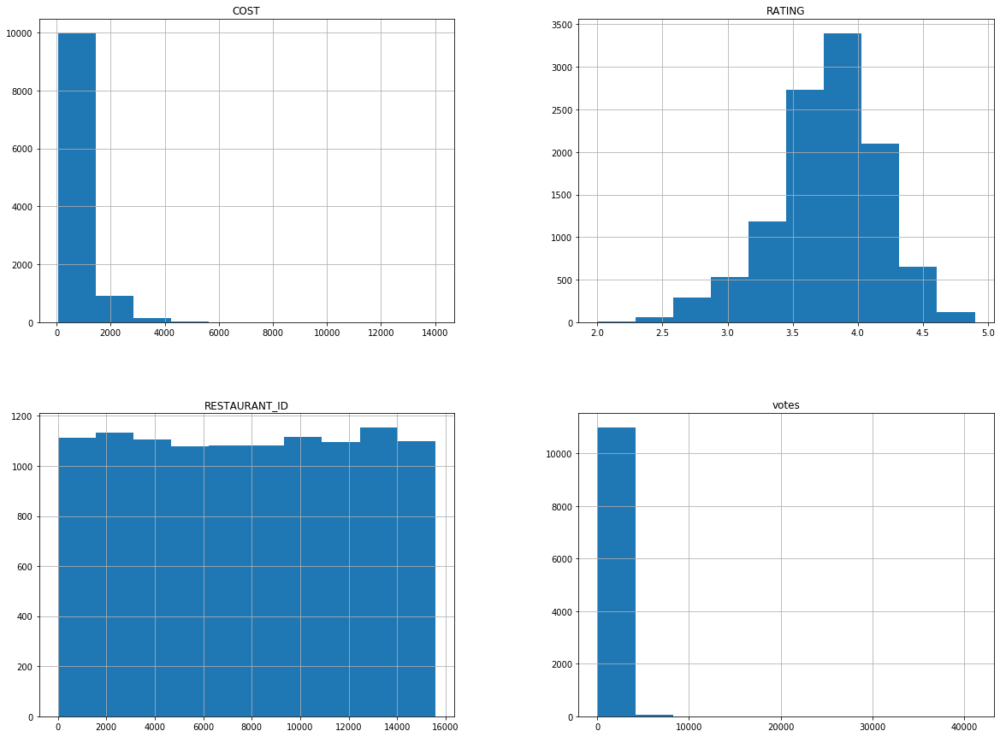

In [77]:
fig = plt.figure(figsize = (20,15))
ax = fig.gca()
df_clean.hist(ax = ax)

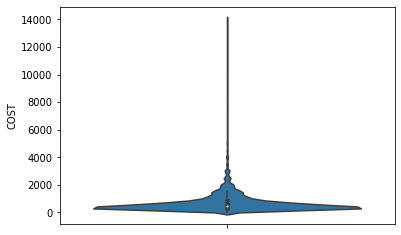

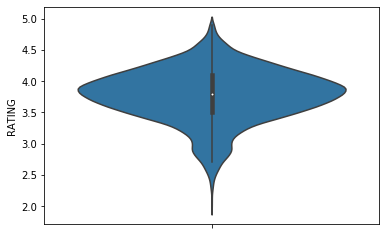

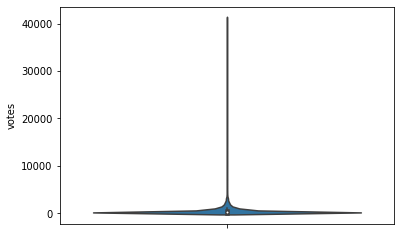

In [78]:
for i in ['COST','RATING','votes']:
    sns.violinplot(y=i,data=df_clean)
    plt.show()

In [79]:
df_clean.nunique()

TITLE              110
RESTAURANT_ID    10391
CITY               328
LOCALITY          1293
RATING              30
COST                81
votes             1819
days                57
0                  857
1                  177
2                    8
c1                  99
c2                  95
c3                  93
c4                  84
c5                  76
c6                  68
c7                  45
c8                  17
dtype: int64

In [80]:
import statistics
for i in ['TITLE','CITY','LOCALITY','RATING','COST','votes','days']:
    print(statistics.mode(df_clean[i]))
    

QUICK BITES
Chennai
Gachibowli
3.9
300.0
44.0
Mon-Sun


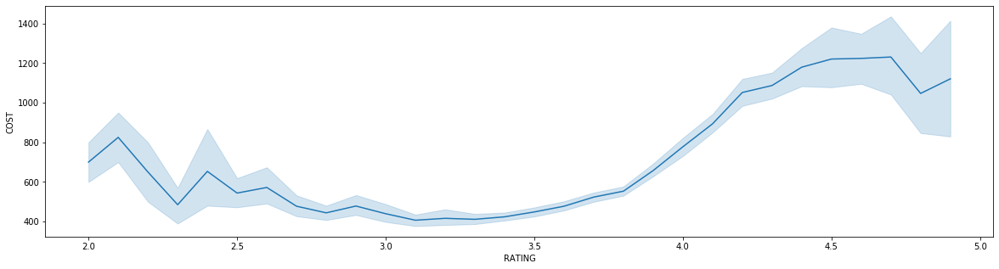

In [81]:
for i in ['RATING']:
    plt.figure(figsize=(20,5))
    sns.lineplot(x=df_clean[i],y=df_clean['COST'],data=df_clean)
    plt.show()

# Combining train and test data for label encoding

In [82]:
df_clean

,TITLE,RESTAURANT_ID,CITY,LOCALITY,RATING,COST,votes,days,0,1,2,c1,c2,c3,c4,c5,c6,c7,c8
0,CASUAL DINING,9438.0,Thane,Dombivali East,3.6,1200.0,49.0,Mon-Sun,11am – 4pm,7:30pm – 11:30pm,None,Malwani,Goan,North Indian,None,None,None,None,None
1,"CASUAL DINING,BAR",13198.0,Chennai,Ramapuram,4.2,1500.0,30.0,Mon-Sun,6pm – 11pm,None,None,Asian,Modern Indian,Japanese,None,None,None,None,None
2,CASUAL DINING,10915.0,Chennai,Saligramam,3.8,800.0,221.0,Mon-Sun,11am – 3:30pm,7pm – 11pm,None,North Indian,Chinese,Biryani,Hyderabadi,None,None,None,None
3,QUICK BITES,6346.0,Mumbai,Bandra West,4.1,800.0,24.0,Mon-Sun,11:30am – 1am,None,None,Tibetan,Chinese,None,None,None,None,None,None
4,DESSERT PARLOR,15387.0,Mumbai,Lower Parel,3.8,300.0,165.0,Mon-Sun,11am – 1am,None,None,Desserts,None,None,None,None,None,None,None
5,CASUAL DINING,5618.0,Mumbai,Vile Parle West,4.0,800.0,550.0,Mon-Sun,12noon – 12:30AM,None,None,North Indian,Chinese,Seafood,Biryani,None,None,None,None
6,CAFÉ,4383.0,Bangalore,Koramangala 6th Block,4.1,600.0,509.0,"Mon, Tue, Thu, Fri, Sat, Sun",12noon – 11:30pm,None,None,Cafe,Chinese,Pizza,North Indian,Burger,None,None,None
7,MICROBREWERY,1249.0,Gurgaon,Sector 29,4.3,1600.0,1612.0,Mon-Sun,1pm – 1am,None,None,Bar Food,None,None,None,None,None,None,None
8,QUICK BITES,7062.0,Bangalore,Bannerghatta Road,3.9,300.0,101.0,Mon-Sun,7am – 10:30pm,None,None,South Indian,North Indian,None,None,None,None,None,None
9,QUICK BITES,10109.0,Hyderabad,Dilsukhnagar,3.3,200.0,219.0,Mon-Sun,11am – 2pm,4pm – 10:30pm,None,North Indian,None,None,None,None,None,None,None


In [83]:
count=df_clean.isnull().sum()
count

TITLE                0
RESTAURANT_ID        0
CITY                 0
LOCALITY             0
RATING               0
COST                 0
votes                0
days                 0
0                    0
1                 9400
2                11036
c1                   0
c2                2489
c3                5897
c4                8585
c5               10126
c6               10675
c7               10896
c8               10989
dtype: int64

In [84]:
count=df_testclean.isnull().sum()
count

TITLE              67
RESTAURANT_ID      67
CITY               67
LOCALITY           67
RATING             67
votes              67
days              120
0                  67
1                3239
2                3763
c1                  0
c2                837
c3               2031
c4               2929
c5               3461
c6               3667
c7               3727
c8               3767
dtype: int64

In [85]:
df_testclean = df_testclean[df_testclean.days.notnull()]

In [86]:
count=df_testclean.isnull().sum()
count

TITLE               0
RESTAURANT_ID       0
CITY                0
LOCALITY            0
RATING              0
votes               0
days                0
0                   0
1                3164
2                3671
c1                  0
c2                810
c3               1966
c4               2837
c5               3351
c6               3551
c7               3609
c8               3648
dtype: int64

In [87]:
df_clean.shape

(11058, 19)

In [88]:
dft = pd.concat([df_clean,df_testclean], ignore_index=True)

In [89]:
count=dft.isnull().sum()
count

TITLE                0
RESTAURANT_ID        0
CITY                 0
LOCALITY             0
RATING               0
COST              3677
votes                0
days                 0
0                    0
1                12564
2                14707
c1                   0
c2                3299
c3                7863
c4               11422
c5               13477
c6               14226
c7               14505
c8               14637
dtype: int64

# Using Labelencoder to transform object values into usable numeric data

In [90]:
from sklearn.preprocessing import LabelEncoder

In [91]:
for i in ['TITLE','CITY','LOCALITY','days']:
    le=LabelEncoder()
    dft[i]=le.fit_transform(dft[i])
    

In [92]:
dft.head()

,TITLE,RESTAURANT_ID,CITY,LOCALITY,RATING,COST,votes,days,0,1,2,c1,c2,c3,c4,c5,c6,c7,c8
0,30,9438.0,360,301,3.6,1200.0,49,55,11am – 4pm,7:30pm – 11:30pm,None,Malwani,Goan,North Indian,None,None,None,None,None
1,32,13198.0,67,1088,4.2,1500.0,30,55,6pm – 11pm,None,None,Asian,Modern Indian,Japanese,None,None,None,None,None
2,30,10915.0,67,1142,3.8,800.0,221,55,11am – 3:30pm,7pm – 11pm,None,North Indian,Chinese,Biryani,Hyderabadi,None,None,None,None
3,99,6346.0,245,145,4.1,800.0,24,55,11:30am – 1am,None,None,Tibetan,Chinese,None,None,None,None,None,None
4,50,15387.0,245,642,3.8,300.0,165,55,11am – 1am,None,None,Desserts,None,None,None,None,None,None,None


In [93]:
dft.dtypes

TITLE              int32
RESTAURANT_ID    float64
CITY               int32
LOCALITY           int32
RATING            object
COST             float64
votes             object
days               int32
0                 object
1                 object
2                 object
c1                object
c2                object
c3                object
c4                object
c5                object
c6                object
c7                object
c8                object
dtype: object

In [94]:
for i in [1,2,'c2','c3','c4','c5','c6','c7','c8']:
    dft[i].fillna('missing', inplace = True) 
  

In [95]:
dft.head()

,TITLE,RESTAURANT_ID,CITY,LOCALITY,RATING,COST,votes,days,0,1,2,c1,c2,c3,c4,c5,c6,c7,c8
0,30,9438.0,360,301,3.6,1200.0,49,55,11am – 4pm,7:30pm – 11:30pm,missing,Malwani,Goan,North Indian,missing,missing,missing,missing,missing
1,32,13198.0,67,1088,4.2,1500.0,30,55,6pm – 11pm,missing,missing,Asian,Modern Indian,Japanese,missing,missing,missing,missing,missing
2,30,10915.0,67,1142,3.8,800.0,221,55,11am – 3:30pm,7pm – 11pm,missing,North Indian,Chinese,Biryani,Hyderabadi,missing,missing,missing,missing
3,99,6346.0,245,145,4.1,800.0,24,55,11:30am – 1am,missing,missing,Tibetan,Chinese,missing,missing,missing,missing,missing,missing
4,50,15387.0,245,642,3.8,300.0,165,55,11am – 1am,missing,missing,Desserts,missing,missing,missing,missing,missing,missing,missing


In [96]:
for i in [0,1,2,'c1','c2','c3','c4','c5','c6','c7','c8']:
    dft[i]=le.fit_transform(dft[i])
  

In [97]:
dft.head()

,TITLE,RESTAURANT_ID,CITY,LOCALITY,RATING,COST,votes,days,0,1,2,c1,c2,c3,c4,c5,c6,c7,c8
0,30,9438.0,360,301,3.6,1200.0,49,55,221,153,12,58,32,70,88,80,73,53,20
1,32,13198.0,67,1088,4.2,1500.0,30,55,649,203,12,5,62,44,88,80,73,53,20
2,30,10915.0,67,1142,3.8,800.0,221,55,210,175,12,70,23,14,34,80,73,53,20
3,99,6346.0,245,145,4.1,800.0,24,55,113,203,12,98,23,99,88,80,73,53,20
4,50,15387.0,245,642,3.8,300.0,165,55,204,203,12,29,98,99,88,80,73,53,20


In [98]:
count=dft.isnull().sum()
count

TITLE               0
RESTAURANT_ID       0
CITY                0
LOCALITY            0
RATING              0
COST             3677
votes               0
days                0
0                   0
1                   0
2                   0
c1                  0
c2                  0
c3                  0
c4                  0
c5                  0
c6                  0
c7                  0
c8                  0
dtype: int64

# Now separating the dataset into initial training and test data

In [99]:
tra=dft.iloc[0:11058]

In [100]:
tra.tail(5)

,TITLE,RESTAURANT_ID,CITY,LOCALITY,RATING,COST,votes,days,0,1,2,c1,c2,c3,c4,c5,c6,c7,c8
11053,99,13228.0,146,358,3.8,500.0,546,37,351,203,12,70,17,47,88,80,73,53,20
11054,32,9686.0,245,142,4.3,1800.0,1214,53,353,203,12,37,25,99,88,80,73,53,20
11055,74,11133.0,267,1396,4,1300.0,608,55,349,203,12,34,25,5,19,80,73,53,20
11056,30,6134.0,67,653,3.5,400.0,32,55,617,203,12,70,85,23,79,80,73,53,20
11057,30,6430.0,146,1387,3.4,600.0,677,55,273,203,12,70,23,99,88,80,73,53,20


In [101]:
dft.shape

(14735, 19)

In [102]:
tes=dft.iloc[11058:14736,]

In [103]:
tes.head(5)

,TITLE,RESTAURANT_ID,CITY,LOCALITY,RATING,COST,votes,days,0,1,2,c1,c2,c3,c4,c5,c6,c7,c8
11058,30,4085.0,290,1183,4.3,NaN,564,55,351,203,12,70,23,66,43,80,73,53,20
11059,99,12680.0,245,392,4.2,NaN,61,55,733,203,12,88,28,76,64,80,73,53,20
11060,30,1411.0,245,701,3.8,NaN,350,55,187,203,12,70,83,14,19,80,73,53,20
11061,90,204.0,115,772,3.8,NaN,1445,47,919,203,12,14,98,99,88,80,73,53,20
11062,99,13453.0,191,517,3.6,NaN,23,55,182,203,12,88,48,99,88,80,73,53,20


# Correlation matrix

In [104]:
tra.dtypes

TITLE              int32
RESTAURANT_ID    float64
CITY               int32
LOCALITY           int32
RATING            object
COST             float64
votes             object
days               int32
0                  int32
1                  int32
2                  int32
c1                 int32
c2                 int32
c3                 int32
c4                 int32
c5                 int32
c6                 int32
c7                 int32
c8                 int32
dtype: object

In [105]:
tra['RATING'] = tra['RATING'].astype(str).astype(float)

In [106]:
tra['votes'] = tra['votes'].astype(str).astype(float)

In [107]:
tra.dtypes

TITLE              int32
RESTAURANT_ID    float64
CITY               int32
LOCALITY           int32
RATING           float64
COST             float64
votes            float64
days               int32
0                  int32
1                  int32
2                  int32
c1                 int32
c2                 int32
c3                 int32
c4                 int32
c5                 int32
c6                 int32
c7                 int32
c8                 int32
dtype: object

In [108]:
dco=tra.corr()
dco

,TITLE,RESTAURANT_ID,CITY,LOCALITY,RATING,COST,votes,days,0,1,2,c1,c2,c3,c4,c5,c6,c7,c8
TITLE,1.000000,0.008111,-0.017643,0.027851,-0.169804,-0.271707,-0.135501,0.003833,0.064904,0.005351,-0.001724,0.234241,0.145066,0.170805,0.145847,0.101991,0.056536,0.028921,0.018600
RESTAURANT_ID,0.008111,1.000000,0.012535,-0.007421,0.036422,0.039352,-0.003101,-0.013302,0.002298,0.002492,-0.008346,0.049669,0.011947,-0.022777,0.003943,-0.005792,-0.009326,-0.018023,-0.009659
CITY,-0.017643,0.012535,1.000000,0.029087,0.062649,0.053656,0.056964,-0.005853,-0.010338,0.060773,0.021201,0.023190,0.001046,-0.015474,-0.007810,-0.009954,-0.008249,-0.010143,-0.003786
LOCALITY,0.027851,-0.007421,0.029087,1.000000,-0.024203,-0.013275,-0.027908,-0.002246,-0.017620,0.004478,-0.005096,0.025244,0.011667,0.007306,0.009799,0.011497,0.012073,0.018564,0.022890
RATING,-0.169804,0.036422,0.062649,-0.024203,1.000000,0.334040,0.348734,-0.057540,0.018547,-0.034548,0.004822,-0.081993,-0.064556,-0.102361,-0.140100,-0.106874,-0.092967,-0.049167,-0.042298
COST,-0.271707,0.039352,0.053656,-0.013275,0.334040,1.000000,0.253046,-0.017940,-0.016504,-0.050108,-0.003305,-0.042367,-0.062485,-0.159564,-0.164922,-0.107154,-0.082854,-0.053893,-0.045757
votes,-0.135501,-0.003101,0.056964,-0.027908,0.348734,0.253046,1.000000,-0.035552,-0.025063,-0.035704,0.008677,-0.046900,-0.079885,-0.144781,-0.135225,-0.097576,-0.068442,-0.059576,-0.065581
days,0.003833,-0.013302,-0.005853,-0.002246,-0.057540,-0.017940,-0.035552,1.000000,0.009562,-0.000316,-0.007854,0.028251,0.019922,0.027210,0.030917,0.029184,0.017539,0.014613,0.010946
0,0.064904,0.002298,-0.010338,-0.017620,0.018547,-0.016504,-0.025063,0.009562,1.000000,0.039679,-0.047665,0.111473,0.083378,0.020737,0.005523,-0.016583,0.006098,-0.001601,0.005219
1,0.005351,0.002492,0.060773,0.004478,-0.034548,-0.050108,-0.035704,-0.000316,0.039679,1.000000,0.196967,-0.044545,-0.038687,-0.018847,0.001841,0.005799,-0.003172,0.022405,-0.000362


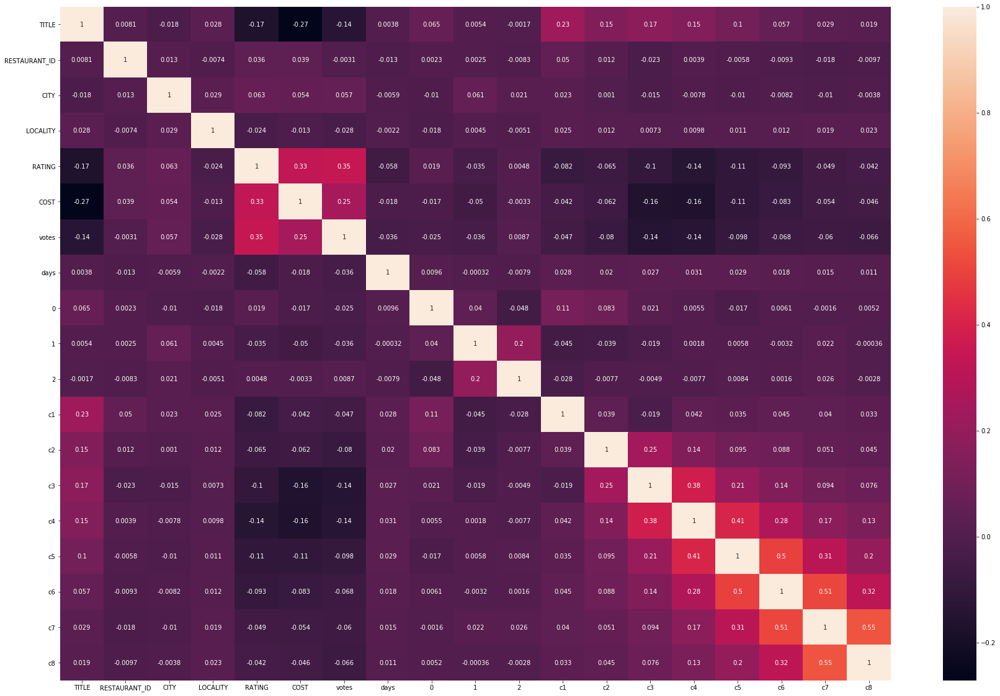

In [109]:
plt.figure(figsize=(30,20))
sns.heatmap(dco,annot=True)

# Statistics Summary

In [110]:
tra.describe()

,TITLE,RESTAURANT_ID,CITY,LOCALITY,RATING,COST,votes,days,0,1,2,c1,c2,c3,c4,c5,c6,c7,c8
count,11058.000000,11058.000000,11058.000000,11058.000000,11058.000000,11058.000000,11058.000000,11058.000000,11058.000000,11058.000000,11058.000000,11058.000000,11058.000000,11058.000000,11058.000000,11058.000000,11058.000000,11058.000000,11058.000000
mean,60.055164,7789.637457,154.696509,680.628233,3.780385,676.218394,416.215229,53.260897,380.651022,193.256647,11.991771,48.309278,55.341472,72.469072,77.267499,76.350063,71.691083,52.533731,19.892295
std,34.803494,4518.118193,97.285660,412.960062,0.421651,633.539454,847.380592,8.169644,257.970466,29.228551,0.223081,27.789155,32.396857,33.585345,23.211226,13.864347,7.764315,4.360029,1.420681
min,0.000000,0.000000,0.000000,0.000000,2.000000,50.000000,4.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,3856.500000,67.000000,351.000000,3.500000,300.000000,57.000000,55.000000,196.000000,203.000000,12.000000,26.000000,23.000000,30.000000,88.000000,80.000000,73.000000,53.000000,20.000000
50%,50.000000,7811.000000,146.000000,611.000000,3.800000,500.000000,163.000000,55.000000,346.000000,203.000000,12.000000,46.000000,61.000000,99.000000,88.000000,80.000000,73.000000,53.000000,20.000000
75%,99.000000,11739.500000,245.000000,1052.000000,4.100000,800.000000,458.750000,55.000000,556.000000,203.000000,12.000000,70.000000,89.000000,99.000000,88.000000,80.000000,73.000000,53.000000,20.000000
max,117.000000,15573.000000,406.000000,1477.000000,4.900000,14000.000000,41186.000000,59.000000,957.000000,203.000000,12.000000,101.000000,98.000000,99.000000,88.000000,80.000000,73.000000,53.000000,20.000000


# The skewed data and certain outliers  need to be cleaned

In [111]:
from scipy.stats import zscore

In [112]:
z_score=abs(zscore(tra))
print(tra.shape)
dffinal=tra.loc[(z_score<3).all(axis=1)]
print(dffinal.shape)

(11058, 19)
(9278, 19)


In [113]:
dffinal.skew()

TITLE            -0.059193
RESTAURANT_ID    -0.000423
CITY              0.311115
LOCALITY          0.336207
RATING           -0.401074
COST              1.832603
votes             2.572424
days             -6.084361
0                 0.736348
1                -3.806993
2                 0.000000
c1               -0.019771
c2                0.047486
c3               -0.882543
c4               -2.553390
c5               -7.836099
c6              -17.685408
c7              -49.778119
c8                0.000000
dtype: float64

In [114]:
xn=dffinal.drop(columns=['COST'])
yn=dffinal['COST']

In [115]:
for col in xn.columns:
    if xn.skew().loc[col]>0.55:
        xn[col]=np.log1p(xn[col])

In [116]:
xn.skew()

TITLE            -0.059193
RESTAURANT_ID    -0.000423
CITY              0.311115
LOCALITY          0.336207
RATING           -0.401074
votes            -0.070880
days             -6.084361
0                -1.300742
1                -3.806993
2                 0.000000
c1               -0.019771
c2                0.047486
c3               -0.882543
c4               -2.553390
c5               -7.836099
c6              -17.685408
c7              -49.778119
c8                0.000000
dtype: float64

# Now,scaling of data has to be done

In [117]:
from sklearn.preprocessing import StandardScaler

In [118]:
scale=StandardScaler()
xn=scale.fit_transform(xn)


In [119]:
xd=pd.DataFrame(xn)

In [120]:
xd.skew()

0     -0.059193
1     -0.000423
2      0.311115
3      0.336207
4     -0.401074
5     -0.070880
6     -6.084361
7     -1.300742
8     -3.806993
9      0.000000
10    -0.019771
11     0.047486
12    -0.882543
13    -2.553390
14    -7.836099
15   -17.685408
16   -49.778119
17     0.000000
dtype: float64

In [121]:
xd.isnull().sum()

0     0
1     0
2     0
3     0
4     0
5     0
6     0
7     0
8     0
9     0
10    0
11    0
12    0
13    0
14    0
15    0
16    0
17    0
dtype: int64

In [122]:
yn.isnull().sum()

0

# Splitting the train dataset at 20% to select best model

In [123]:
from sklearn.model_selection import train_test_split
xtrain,xtest,ytrain,ytest=train_test_split(xd,yn,test_size=.20,random_state=42)

In [124]:
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import Lasso,Ridge,ElasticNet
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.externals import joblib

In [125]:
def maxr2_score(regr,xd,yn):
    max_r_score=0
    for r_state in range(42,100):
        xtrain,xtest,ytrain,ytest=train_test_split(xd,yn,test_size=.20,random_state=r_state)
        regr.fit(xtrain,ytrain)
        ypred=regr.predict(xtest)
        r2_scr=r2_score(ytest,ypred)
        print('r2 score corresponding to ',r_state,'is',r2_scr)
        if r2_scr>max_r_score:
            max_r_score= r2_scr
            finalrstate=r_state
    print('max r2 score corresponding to',finalrstate,'is',max_r_score)
    return finalrstate

In [126]:
lr = LinearRegression()
svr = SVR()
knr=KNeighborsRegressor()
rfr=RandomForestRegressor()
gbr=GradientBoostingRegressor()
ada=AdaBoostRegressor()
dtr=DecisionTreeRegressor()

parameters={'C': [100, 10, 1.0, 0.1,0.01],'kernel':['linear','poly', 'rbf']}
clf=GridSearchCV(svr,parameters)
clf.fit(xd,yn)
print('best SVR parameters is :',clf.best_params_)
print('\n')
parameters={'n_neighbors':range(1,30)}
clf=GridSearchCV(knr,parameters)
clf.fit(xd,yn)
print('best KNR parameters is :',clf.best_params_)
print('\n')
parameters={'n_estimators':[50,100,150,200,250,300]}
clf=GridSearchCV(rfr,parameters,cv=5)
clf.fit(xd,yn)
print('best RFR parameters is :',clf.best_params_)
print('\n')
parameters={'learning_rate':[0.001,0.01,0.1,1],'n_estimators':[50,100,150,200,250,300]}
clf=GridSearchCV(gbr,parameters,cv=5)
clf.fit(xd,yn)
print('best GBR parameters is :',clf.best_params_)
print('\n')
parameters={'learning_rate':[0.01,0.1,1],'n_estimators':[50,100,150,200,250,300],'base_estimator':[lr,dtr]}
clf=GridSearchCV(ada,parameters,cv=5)
clf.fit(xd,yn)
print('best ADA parameters is :',clf.best_params_)
print('\n')
alphavalue={'alpha':[1,0.1,0.001,0.0001]}
list=[Lasso(),Ridge(),ElasticNet()]
for i in list:
    grid=GridSearchCV(estimator=i,param_grid=alphavalue)
    grid.fit(xd,yn)
    print(grid.best_score_)
    print(grid.best_estimator_.alpha)
    print(grid.best_params_)
    print('\n')

best SVR parameters is : {'C': 100, 'kernel': 'rbf'}


best KNR parameters is : {'n_neighbors': 22}


best RFR parameters is : {'n_estimators': 250}


best GBR parameters is : {'learning_rate': 0.1, 'n_estimators': 300}


best ADA parameters is : {'base_estimator': DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best'), 'learning_rate': 1, 'n_estimators': 300}


0.2822972799061669
0.1
{'alpha': 0.1}


0.2822935837621515
1
{'alpha': 1}


0.2822951870805216
0.001
{'alpha': 0.001}




In [127]:
lr = LinearRegression()
r_state=maxr2_score(lr,xd,yn)
print('\n')
svr = SVR(C=100,kernel='rbf')
r_state=maxr2_score(svr,xd,yn)
print('\n')
knr=KNeighborsRegressor(n_neighbors= 22)
r_state=maxr2_score(knr,xd,yn)
print('\n')
rfr=RandomForestRegressor(n_estimators=250)
r_state=maxr2_score(rfr,xd,yn)
print('\n')
gbr=GradientBoostingRegressor(learning_rate=0.1,n_estimators=300)
r_state=maxr2_score(gbr,xd,yn)
print('\n')
ada=AdaBoostRegressor(learning_rate=1,n_estimators=300,base_estimator=dtr)
r_state=maxr2_score(ada,xd,yn)
print('\n')
la=Lasso(alpha=0.1)
r_state=maxr2_score(la,xd,yn)
print('\n')


r2 score corresponding to  42 is 0.27044669152724377
r2 score corresponding to  43 is 0.25132359679981997
r2 score corresponding to  44 is 0.2907123996854978
r2 score corresponding to  45 is 0.2936363734207974
r2 score corresponding to  46 is 0.27900585759758223
r2 score corresponding to  47 is 0.27357336364976714
r2 score corresponding to  48 is 0.243701657810376
r2 score corresponding to  49 is 0.26653347744791056
r2 score corresponding to  50 is 0.26378666981249355
r2 score corresponding to  51 is 0.3018143666922005
r2 score corresponding to  52 is 0.2829730968598432
r2 score corresponding to  53 is 0.3010143759557752
r2 score corresponding to  54 is 0.2828646853245044
r2 score corresponding to  55 is 0.29546655177315617
r2 score corresponding to  56 is 0.3090390819112112
r2 score corresponding to  57 is 0.2677237515612728
r2 score corresponding to  58 is 0.2624864821201909
r2 score corresponding to  59 is 0.2877085100607678
r2 score corresponding to  60 is 0.287192120558451
r2 scor

r2 score corresponding to  81 is 0.33616594472520256
r2 score corresponding to  82 is 0.3642007289290077
r2 score corresponding to  83 is 0.3486097022904602
r2 score corresponding to  84 is 0.34122106156487453
r2 score corresponding to  85 is 0.37961368869250156
r2 score corresponding to  86 is 0.37639728607782885
r2 score corresponding to  87 is 0.3360714091279523
r2 score corresponding to  88 is 0.34739571447516815
r2 score corresponding to  89 is 0.3623955587834704
r2 score corresponding to  90 is 0.3662060031508081
r2 score corresponding to  91 is 0.3613440631686573
r2 score corresponding to  92 is 0.38541865092473915
r2 score corresponding to  93 is 0.34926469415042194
r2 score corresponding to  94 is 0.3549827058842473
r2 score corresponding to  95 is 0.3687894768329878
r2 score corresponding to  96 is 0.3323145000048743
r2 score corresponding to  97 is 0.39956225180764204
r2 score corresponding to  98 is 0.3383043570766635
r2 score corresponding to  99 is 0.3499494363789326
max 

r2 score corresponding to  62 is 0.6973023133129052
r2 score corresponding to  63 is 0.7070580360531953
r2 score corresponding to  64 is 0.7134557598947211
r2 score corresponding to  65 is 0.7118658249227465
r2 score corresponding to  66 is 0.7097097044885481
r2 score corresponding to  67 is 0.7132042843548945
r2 score corresponding to  68 is 0.7044833848655734
r2 score corresponding to  69 is 0.6974361092811876
r2 score corresponding to  70 is 0.7162294706477688
r2 score corresponding to  71 is 0.7275362180292919
r2 score corresponding to  72 is 0.7173108379014026
r2 score corresponding to  73 is 0.6986421885301961
r2 score corresponding to  74 is 0.6892904121087264
r2 score corresponding to  75 is 0.7014383795745966
r2 score corresponding to  76 is 0.6813137646859666
r2 score corresponding to  77 is 0.7168079980094322
r2 score corresponding to  78 is 0.7266338606366582
r2 score corresponding to  79 is 0.7076409083869724
r2 score corresponding to  80 is 0.6733748941492491
r2 score cor

In [128]:
models=[]
models.append(('LinearRegression',lr))
models.append(('SVR',svr))
models.append(('kNeighborsRegressor',knr))
models.append(('RFR',rfr))
models.append(('GBR',gbr))
models.append(('ADAREG',ada))
models.append(('Lasso',la))


In [129]:
from sklearn.model_selection import cross_val_score

In [130]:
Model=[]
score=[]
cvs=[]
for name,model in models:
    print('****,name,****')
    print('\n')
    Model.append(name)
    model.fit(xtrain,ytrain)
    print(model)
    pre=model.predict(xtest)
    print('\n')
    RS=r2_score(ytest,pre)
    print('r2 score',RS)
    score.append(RS*100)
    print('\n')
    sc=cross_val_score(model,xd,yn,cv=5,scoring='r2').mean()
    print('Cross val score',sc)
    cvs.append(sc*100)
    print('\n')

****,name,****


LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)


r2 score 0.27044669152724377


Cross val score 0.2822929925320373


****,name,****


SVR(C=100, cache_size=200, coef0=0.0, degree=3, epsilon=0.1, gamma='scale',
    kernel='rbf', max_iter=-1, shrinking=True, tol=0.001, verbose=False)


r2 score 0.3290080058594461


Cross val score 0.33124339835326266


****,name,****


KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=None, n_neighbors=22, p=2,
                    weights='uniform')


r2 score 0.35290009538013933


Cross val score 0.36360821267562915


****,name,****


RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      m

In [131]:
result=pd.DataFrame({'Model':Model,'r2_score': score,'Cross val score': cvs})
result

,Model,r2_score,Cross val score
0,LinearRegression,27.044669,28.229299
1,SVR,32.900801,33.124340
2,kNeighborsRegressor,35.290010,36.360821
3,RFR,67.608592,69.625129
4,GBR,69.928277,70.180017
5,ADAREG,68.137373,69.842920
6,Lasso,27.046909,28.229728


# After having tried all the above models , GBR is working best
Also, random state corresponding to max r2 score in RFR is 97

In [134]:
xtrain,xtest,ytrain,ytest=train_test_split(xd,yn,test_size=.20,random_state=97)
gbr=GradientBoostingRegressor(learning_rate=0.1,n_estimators=300)
gbr.fit(xtrain,ytrain)
ypred=gbr.predict(xtest)

# Final model is as follows

In [135]:
print('RMSE is',np.sqrt(mean_squared_error(ytest,ypred)))
print('r2_score is',r2_score(ytest,ypred))

RMSE is 234.30937395989108
r2_score is 0.7297371189553551


# Getting the test file

In [136]:
tes.head(5)

,TITLE,RESTAURANT_ID,CITY,LOCALITY,RATING,COST,votes,days,0,1,2,c1,c2,c3,c4,c5,c6,c7,c8
11058,30,4085.0,290,1183,4.3,NaN,564,55,351,203,12,70,23,66,43,80,73,53,20
11059,99,12680.0,245,392,4.2,NaN,61,55,733,203,12,88,28,76,64,80,73,53,20
11060,30,1411.0,245,701,3.8,NaN,350,55,187,203,12,70,83,14,19,80,73,53,20
11061,90,204.0,115,772,3.8,NaN,1445,47,919,203,12,14,98,99,88,80,73,53,20
11062,99,13453.0,191,517,3.6,NaN,23,55,182,203,12,88,48,99,88,80,73,53,20


In [137]:
tes.drop(columns=['COST'],inplace=True)

In [138]:
tes.isnull().sum()

TITLE            0
RESTAURANT_ID    0
CITY             0
LOCALITY         0
RATING           0
votes            0
days             0
0                0
1                0
2                0
c1               0
c2               0
c3               0
c4               0
c5               0
c6               0
c7               0
c8               0
dtype: int64

In [140]:
tes.dtypes

TITLE              int32
RESTAURANT_ID    float64
CITY               int32
LOCALITY           int32
RATING            object
votes             object
days               int32
0                  int32
1                  int32
2                  int32
c1                 int32
c2                 int32
c3                 int32
c4                 int32
c5                 int32
c6                 int32
c7                 int32
c8                 int32
dtype: object

In [141]:
tes['RATING'] = pd.to_numeric(tes['RATING'])
tes['votes'] = pd.to_numeric(tes['votes'])

In [142]:
tes.dtypes

TITLE              int32
RESTAURANT_ID    float64
CITY               int32
LOCALITY           int32
RATING           float64
votes              int64
days               int32
0                  int32
1                  int32
2                  int32
c1                 int32
c2                 int32
c3                 int32
c4                 int32
c5                 int32
c6                 int32
c7                 int32
c8                 int32
dtype: object

In [143]:
z_score=abs(zscore(tes))
print(tes.shape)
dfnew=tes.loc[(z_score<3).all(axis=1)]
print(dfnew.shape)

(3677, 18)
(3141, 18)


In [144]:
dfnew.skew()

TITLE            -0.015729
RESTAURANT_ID    -0.015225
CITY              0.275594
LOCALITY          0.365516
RATING           -0.514641
votes             2.553326
days             -6.449853
0                 0.698301
1                -3.712914
2                 0.000000
c1               -0.052342
c2                0.094290
c3               -0.922896
c4               -2.561201
c5               -7.280660
c6              -18.863219
c7              -41.367352
c8                0.000000
dtype: float64

In [145]:
for col in dfnew.columns:
    if dfnew.skew().loc[col]>0.55:
        dfnew[col]=np.log1p(dfnew[col])

In [146]:
dfnew.isnull().sum()

TITLE            0
RESTAURANT_ID    0
CITY             0
LOCALITY         0
RATING           0
votes            0
days             0
0                0
1                0
2                0
c1               0
c2               0
c3               0
c4               0
c5               0
c6               0
c7               0
c8               0
dtype: int64

In [147]:
scale=StandardScaler()
dfnew=scale.fit_transform(dfnew)


In [148]:
d_final=pd.DataFrame(dfnew)


In [149]:
d_final.isnull().sum()

0     0
1     0
2     0
3     0
4     0
5     0
6     0
7     0
8     0
9     0
10    0
11    0
12    0
13    0
14    0
15    0
16    0
17    0
dtype: int64

In [150]:
joblib.dump(gbr,'Model_restaurant.obj')

['Model_restaurant.obj']

In [151]:
model=joblib.load('Model_restaurant.obj')

# Using the test file

In [152]:
model.predict(d_final)

array([1232.65995384,  426.19609693,  685.56616978, ...,  837.88695294,
        376.3500664 ,  413.68517935])